# FlameScope: Foreseeing Forest Fires

### Step 1 - Define the problem and goal

### Problem Statement

**_Prediction of Forest Fire Impact Area Based on Geographical and Temporal Characteristics_**

`How well can we identify the area that gets affected given the geographical and temporal characteristics? By leveraging advanced data science algorithms and analyzing various related information, such as location, time, and other relevant factors, our model aims to forecast the extent of forest fire impact with a high degree of precision. Through rigorous data analysis and predictive modeling, our project aims to contribute to proactive fire management strategies and decision-making, enabling better preparedness, mitigation, and response measures for forest fires.`

Predicting the exact area affected by a forest fire can be challenging due to various factors, such as the dynamic nature of fires and the complexity of environmental conditions. However, even classifying forest fires as severe or not based on accurate prediction can provide several benefits:

**1. Early warning and evacuation**: By classifying forest fires as severe or not, authorities can issue early warnings to communities in the potential path of the fire. This can help facilitate timely evacuations, reducing the risk to human life and property.

**2. Resource allocation**: Accurate classification of forest fires can aid in the optimal allocation of firefighting resources. If a fire is classified as severe, additional resources can be deployed to suppress the fire more effectively, while resources can be allocated to other areas if a fire is determined to be less severe.

**3. Risk assessment and planning**: Classifying forest fires can help assess the potential risks to nearby infrastructure, such as buildings, roads, and power lines, and aid in planning for fire response and recovery efforts.

**4. Environmental impact assessment**: Determining the severity of a forest fire can help estimate the potential environmental impact, including damage to vegetation, wildlife habitats, and water sources. This information can inform post-fire recovery plans and ecosystem management strategies.

**5. Cost-effective resource management**: Accurate classification of forest fires can optimize resource management, leading to more cost-effective deployment of firefighting resources and budgeting for fire suppression efforts.

**6. Integrated early warning systems**: Integrated early warning systems that classify forest fires based on severity can provide timely and targeted alerts to authorities and communities at risk. This can facilitate emergency response and evacuation efforts, improving overall fire management.

In summary, while predicting the exact area affected by a forest fire may be challenging, accurately classifying forest fires as severe or not can still provide several benefits, including early warning and evacuation, efficient resource allocation, risk assessment, environmental impact assessment, cost-effective resource management, and integrated early warning systems.

### Step 2 - Data Wrangling

##### 2A - Data Gathering

* Our project was inspired by the Forest Fires Data Set from UC Irvine, which unfortunately had limited observations and missing values.
* To overcome this limitation, we embarked on collecting our own dataset from data.gov, which provided comprehensive information on forest fires in the US over the past years.
* Each forest fire in our dataset was uniquely identified, and we obtained data on the affected area from the mtbs.gov website through web scraping, as there were download limitations.
* The unique ID associated with each forest fire from mtbs.gov allowed us to accurately record the extent of the fire and incorporate it into our dataset.
* We utilized web scraping techniques to extract the required data from mtbs.gov, overcoming the download limitations and ensuring the completeness of our dataset.
* In addition to temporal data, we also obtained geographical data from the open-meteo.com API.
* The open-meteo.com API provided us with detailed geographical information, including coordinates and other relevant data, which enriched our dataset with spatial context.
* We made API calls to open-meteo.com and retrieved the geographical data required for our analysis, enhancing the comprehensiveness of our dataset.
* By combining the data from UC Irvine's Forest Fires Data Set, our own data collected from data.gov and mtbs.gov through web scraping, and geographical data from the open-meteo.com API, we now have a robust dataset with target, geographical, and temporal information about forest fires.
* This enriched dataset enables us to conduct a more comprehensive analysis of forest fires, considering various factors such as time, location, and extent of the fire, which can provide valuable insights for our research.


References:
1. Forest Fires Data Set. UC Irvine Machine Learning Repository. https://archive.ics.uci.edu/ml/datasets/Forest+Fires

2. Monitoring Trends in Burn Severity (MTBS) - Burned Area Boundaries Feature Layer. data.gov. https://catalog.data.gov/dataset/monitoring-trends-in-burn-severity-burned-area-boundaries-feature-layer-27201

3. MTBS Direct Download. mtbs.gov. https://www.mtbs.gov/direct-download

4. Open Meteo API Documentation. open-meteo.com. https://open-meteo.com/en/docs

##### 2B - Describe the dataset

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
forest_fires = pd.read_csv("forest_fire_dataset.csv")

In [3]:
forest_fires.shape

(14186, 27)

In [4]:
forest_fires.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14186 entries, 0 to 14185
Data columns (total 27 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Unnamed: 0                  14186 non-null  int64  
 1   FIRE_ID                     14186 non-null  object 
 2   Fire Name                   14186 non-null  object 
 3   Acres                       14186 non-null  float64
 4   Date                        14186 non-null  object 
 5   Fire Type                   14186 non-null  object 
 6   LATITUDE                    14186 non-null  float64
 7   LONGITUDE                   14186 non-null  float64
 8   time                        14186 non-null  object 
 9   weathercode                 14186 non-null  int64  
 10  temperature_2m_max          14186 non-null  float64
 11  temperature_2m_min          14186 non-null  float64
 12  temperature_2m_mean         14186 non-null  float64
 13  apparent_temperature_max    141

In [5]:
forest_fires.head()

,Unnamed: 0,FIRE_ID,Fire Name,Acres,Date,Fire Type,LATITUDE,LONGITUDE,time,weathercode,...,sunset,shortwave_radiation_sum,precipitation_sum,rain_sum,snowfall_sum,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration
0,0,AL3026908763820110625,POSSUM ROAD,924.0,2011-06-25,Wildfire,30.276,-87.631,'2011-06-25',53,...,'2011-06-25T19:57',24.88,0.8,0.8,0.0,2.0,13.6,28.1,219,5.41
1,1,AL3034808781020141129,MAGNOLIA SPRINGS,803.0,2014-11-29,Wildfire,30.340,-87.808,'2014-11-29',1,...,'2014-11-29T17:51',12.90,0.0,0.0,0.0,0.0,15.2,30.2,151,2.58
2,2,AL3038308812219980404,UNNAMED,705.0,1998-04-04,Wildfire,30.383,-88.122,'1998-04-04',0,...,'1998-04-04T19:14',25.75,0.0,0.0,0.0,0.0,20.6,37.1,337,5.14
3,3,AL3040308827519960214,UNNAMED,987.0,1996-02-14,Wildfire,30.403,-88.275,'1996-02-14',0,...,'1996-02-14T18:41',17.76,0.0,0.0,0.0,0.0,24.1,45.4,213,2.91
4,4,AL3041008828620070325,BAYOU LB,3066.0,2007-03-25,Wildfire,30.410,-88.286,'2007-03-25',3,...,'2007-03-25T19:08',22.86,0.0,0.0,0.0,0.0,12.4,25.2,155,4.15


The dataset consists of 14186 observations and 27 features.

The various features are described below.
- FIRE_ID - A unique identifier assigned to each fire
- Fire Name - Unique name given to the fire
- Acres - Total number of acres burned by the fire
- Date - Date when the fire was first ignited
- Fire Type - Represents the type of the fire. It can take values like "Wildfire", "Prescribed Fire", or "Human-caused"
- LATITUDE - Latitude of the location. Ranges from -90 to 90
- LONGITUDE - Longitude of the location. Ranges from -180 to 180
- time - Date when the fire was first ignited
- weathercode - The most severe weather condition on a given day (WMO code)
- temperature_2m_max - Maximum daily air temperature at 2 meters above ground (°C)
- temperature_2m_min - Minimum daily air temperature at 2 meters above ground (°C)
- temperature_2m_mean - Mean daily air temperature at 2 meters above ground (°C)
- apparent_temperature_max - Maximum and minimum daily apparent temperature. Apparent temperature, also known as feels like, is the temperature equivalent perceived by humans, caused by the combined effects of air temperature, relative humidity and wind speed (°C)
- apparent_temperature_min - Minimum daily apparent temperature (°C)
- apparent_temperature_mean - Mean daily apparent temperature (°C)
- sunrise - Sun rise time (iso8601)
- sunset - Sun set time (iso8601)
- shortwave_radiation_sum - The sum of solar radiation on a given day in Megajoules (MJ/m²)
- precipitation_sum - Sum of daily precipitation, including rain, showers and snowfall (mm)
- rain_sum - Sum of daily rain (mm)
- snowfall_sum - Sum of daily snowfall (mm)
- precipitation_hours - The number of hours with rain (hours)
- windspeed_10m_max - Maximum wind speed on a day (km/h)
- windgusts_10m_max - Maximum wind gusts on a day (km/h)
- winddirection_10m_dominant - Dominant wind direction (°)
- et0_fao_evapotranspiration - Daily sum of ET₀ Reference Evapotranspiration of a well watered grass field (mm)

##### 2C - Data Assesment

###### Manual Assesment
Observations after skimming through the dataset:
- Not all fires are assigned a name (Indicated by the value UNNAMED in the Fire Name column)
- Strangely there are integer values in the Fire Name column (For instance, observation numbered 231)
- The features date and time have the same value i.e, the date of fire ignition contrary to what one might presume
- sunrise and sunset contains both date and time
- precipitation_sum equals rain_sum throughout the dataset
- snowfall_sum equals 0 throughout the dataset
- No missing values found in the dataset

###### Programmatic Assesment

1. Data looks decent and the variables have specicific types representing and adhers to the definition.

##### 2D - Data Cleaning

We will get actual information "Date" from the original dataset by addition of additional columns for precison using datetime.

In [6]:
# Parsing the column to help the same
forest_fires['Date'] = pd.to_datetime(forest_fires['Date'])

In [7]:
# Add datetime parameters for saledate
forest_fires.loc[:, "Year"] = forest_fires['Date'].dt.year
forest_fires.loc[:, "Month"] = forest_fires['Date'].dt.month

forest_fires.head()

,Unnamed: 0,FIRE_ID,Fire Name,Acres,Date,Fire Type,LATITUDE,LONGITUDE,time,weathercode,...,precipitation_sum,rain_sum,snowfall_sum,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration,Year,Month
0,0,AL3026908763820110625,POSSUM ROAD,924.0,2011-06-25,Wildfire,30.276,-87.631,'2011-06-25',53,...,0.8,0.8,0.0,2.0,13.6,28.1,219,5.41,2011,6
1,1,AL3034808781020141129,MAGNOLIA SPRINGS,803.0,2014-11-29,Wildfire,30.340,-87.808,'2014-11-29',1,...,0.0,0.0,0.0,0.0,15.2,30.2,151,2.58,2014,11
2,2,AL3038308812219980404,UNNAMED,705.0,1998-04-04,Wildfire,30.383,-88.122,'1998-04-04',0,...,0.0,0.0,0.0,0.0,20.6,37.1,337,5.14,1998,4
3,3,AL3040308827519960214,UNNAMED,987.0,1996-02-14,Wildfire,30.403,-88.275,'1996-02-14',0,...,0.0,0.0,0.0,0.0,24.1,45.4,213,2.91,1996,2
4,4,AL3041008828620070325,BAYOU LB,3066.0,2007-03-25,Wildfire,30.410,-88.286,'2007-03-25',3,...,0.0,0.0,0.0,0.0,12.4,25.2,155,4.15,2007,3


The attributes Latitude and Longitiude collectively give the information about a location. It does not make sense to use them as different attributes. Lets find a way to merge them. 

Reasons to do so:

1. Simplified Data: Combining latitude and longitude into a single column can simplify the data, making it easier to manage and analyze. Instead of dealing with two separate columns, you would have one composite feature representing the spatial information.

2. Feature Interaction: Combining latitude and longitude into a single feature can capture interactions between these variables that may be relevant for your prediction task. For example, certain areas may have unique characteristics or interactions between latitude and longitude that impact your target variable.

3. Model Performance: Combining latitude and longitude into a single column can potentially improve model performance. Some machine learning algorithms may struggle with high-dimensional data or may not effectively capture interactions between separate features. Combining latitude and longitude into a single column can mitigate these issues and potentially lead to better model performance.

We need some value that the model can read which is meaningful and interpretable. We can create a Point type from geopandas library, but that would be difficult for the model to interpret. 
One way is to get a central location and calculate the distance for every instance from that location. Selecting the central loc for this is a decision to be made. As our future model learns from these set of data that we have, lets take the mean of these data points itself to create a central loc, and let's use the same.

In [8]:
# Calculate the mean latitude and longitude
mean_latitude = forest_fires['LATITUDE'].mean()
mean_longitude = forest_fires['LONGITUDE'].mean()

# Print the mean latitude and longitude
print("Mean Latitude: ", mean_latitude)
print("Mean Longitude: ", mean_longitude)

# Set the mean latitude and longitude as the central location
central_latitude = mean_latitude
central_longitude = mean_longitude

Mean Latitude:  40.559983927816155
Mean Longitude:  -109.75417016777105


In [9]:
# Calculate the distance form this reference points
from math import radians, sin, cos, sqrt, atan2

# Function to calculate distance between two points using haversine formula
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # radius of Earth in km
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = sin(dlat / 2) ** 2 + cos(lat1) * cos(lat2) * sin(dlon / 2) ** 2
    c = 2 * atan2(sqrt(a), sqrt(1 - a))
    distance = R * c
    return distance

# Calculate distance from mean latitude and longitude to each data point
forest_fires['Distance_from_central'] = forest_fires.apply(lambda row: haversine(central_latitude, central_longitude, row['LATITUDE'], row['LONGITUDE']), axis=1)


In [10]:
forest_fires.head()

,Unnamed: 0,FIRE_ID,Fire Name,Acres,Date,Fire Type,LATITUDE,LONGITUDE,time,weathercode,...,rain_sum,snowfall_sum,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration,Year,Month,Distance_from_central
0,0,AL3026908763820110625,POSSUM ROAD,924.0,2011-06-25,Wildfire,30.276,-87.631,'2011-06-25',53,...,0.8,0.0,2.0,13.6,28.1,219,5.41,2011,6,2298.376548
1,1,AL3034808781020141129,MAGNOLIA SPRINGS,803.0,2014-11-29,Wildfire,30.340,-87.808,'2014-11-29',1,...,0.0,0.0,0.0,15.2,30.2,151,2.58,2014,11,2280.436499
2,2,AL3038308812219980404,UNNAMED,705.0,1998-04-04,Wildfire,30.383,-88.122,'1998-04-04',0,...,0.0,0.0,0.0,20.6,37.1,337,5.14,1998,4,2253.240455
3,3,AL3040308827519960214,UNNAMED,987.0,1996-02-14,Wildfire,30.403,-88.275,'1996-02-14',0,...,0.0,0.0,0.0,24.1,45.4,213,2.91,1996,2,2240.070732
4,4,AL3041008828620070325,BAYOU LB,3066.0,2007-03-25,Wildfire,30.410,-88.286,'2007-03-25',3,...,0.0,0.0,0.0,12.4,25.2,155,4.15,2007,3,2238.759764


In [11]:
forest_fires.columns

Index(['Unnamed: 0', 'FIRE_ID', 'Fire Name', 'Acres', 'Date', 'Fire Type',
       'LATITUDE', 'LONGITUDE', 'time', 'weathercode', 'temperature_2m_max',
       'temperature_2m_min', 'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean', 'sunrise',
       'sunset', 'shortwave_radiation_sum', 'precipitation_sum', 'rain_sum',
       'snowfall_sum', 'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central'],
      dtype='object')

Lets now take the variables we are interested in


They are: 
1. 'Acres'
2. 'temperature_2m_max'
3. 'temperature_2m_min' 
4. 'temperature_2m_mean' 
5. 'apparent_temperature_max'
6. 'apparent_temperature_min' 
7. 'apparent_temperature_mean'
8. 'shortwave_radiation_sum'
9. 'precipitation_sum' 
10. 'rain_sum'
11. 'snowfall_sum'
12. 'precipitation_hours'
13. 'windspeed_10m_max'
14. 'windgusts_10m_max' 
15. 'winddirection_10m_dominant' 
16. 'et0_fao_evapotranspiration' 
17. 'Year' 
18. 'Month' 
19. 'Distance_from_central'

In [12]:
columns = ['Acres', 'temperature_2m_max',
       'temperature_2m_min', 'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean', 'shortwave_radiation_sum', 
       'precipitation_sum', 'rain_sum',
       'snowfall_sum', 'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central']
df = forest_fires[columns]
df.head()

,Acres,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,apparent_temperature_mean,shortwave_radiation_sum,precipitation_sum,rain_sum,snowfall_sum,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration,Year,Month,Distance_from_central
0,924.0,31.8,24.3,28.0,36.3,28.2,32.5,24.88,0.8,0.8,0.0,2.0,13.6,28.1,219,5.41,2011,6,2298.376548
1,803.0,19.3,12.1,16.0,17.3,9.6,14.4,12.90,0.0,0.0,0.0,0.0,15.2,30.2,151,2.58,2014,11,2280.436499
2,705.0,21.6,15.1,18.7,21.1,11.5,17.0,25.75,0.0,0.0,0.0,0.0,20.6,37.1,337,5.14,1998,4,2253.240455
3,987.0,17.4,11.1,14.2,15.2,7.3,11.4,17.76,0.0,0.0,0.0,0.0,24.1,45.4,213,2.91,1996,2,2240.070732
4,3066.0,24.9,16.1,20.5,27.2,17.1,21.9,22.86,0.0,0.0,0.0,0.0,12.4,25.2,155,4.15,2007,3,2238.759764


### Step 4 - EDA

##### 4A - Univariate Analysis

1. Lets see our target - Acres

In [13]:
# A generic function for univariate analysis

def univariate_analysys(target_name, target):
    # Histogram
    plt.figure(figsize=(8, 6))
    sns.histplot(target, bins=10)
    plt.title(target_name)
    plt.xlabel("Value")
    plt.ylabel("Frequency")
    plt.show()

    # Box plot
    plt.figure(figsize=(8, 6))
    sns.boxplot(y=target)
    plt.title(target_name)
    plt.ylabel("Value")
    plt.show()

    # Measures of central tendency
    print("Mean:", target.mean())
    print("Median:", target.median())
    print("Mode:", target.mode().iloc[0])

    # Measures of dispersion
    print("Range:", target.max() - target.min())
    print("Variance:", target.var())
    print("Standard Deviation:", target.std())

    # Measure of skewness
    print("Measure of Skewness:", target.skew())

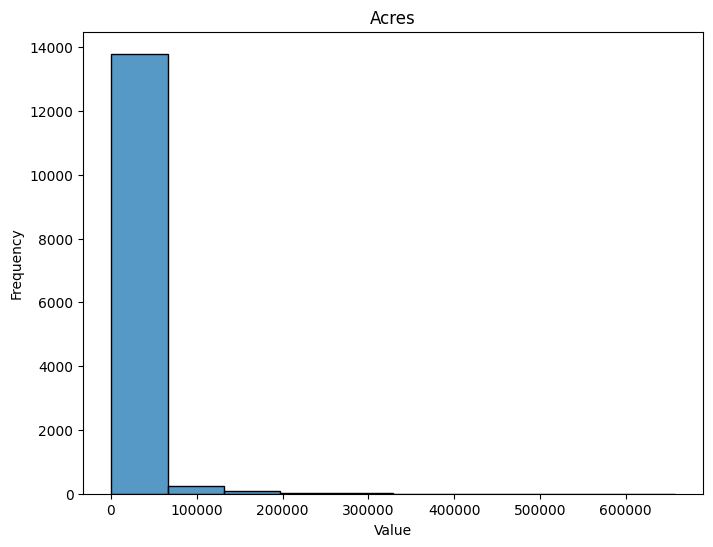

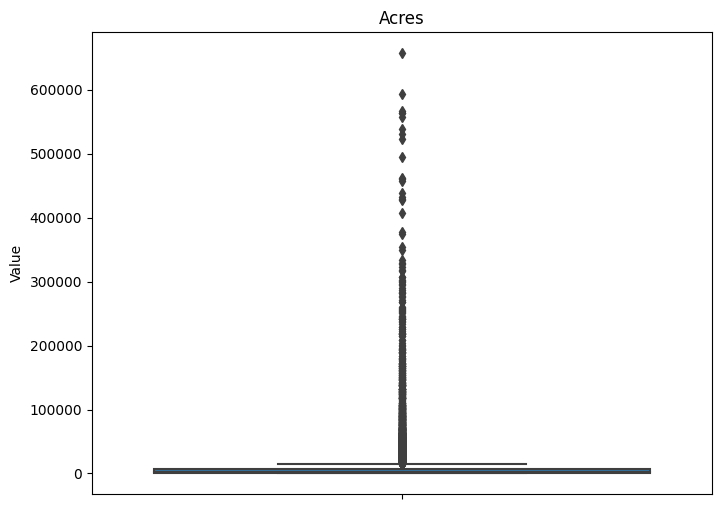

Mean: 10426.834555195263
Median: 2754.5
Mode: 1181.0
Range: 656799.0
Variance: 953545456.6417142
Standard Deviation: 30879.531353984537
Measure of Skewness: 9.240413471251717


In [14]:
univariate_analysys('Acres', df['Acres'])

Acres is very much right skewed.
Lets apply log transformation

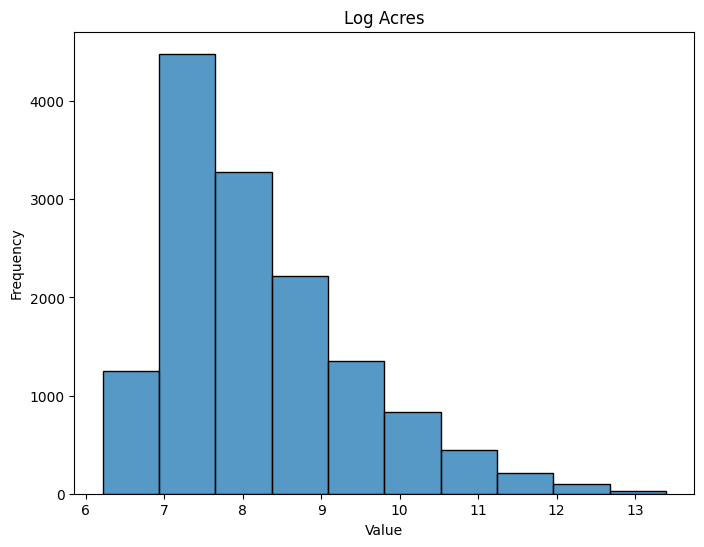

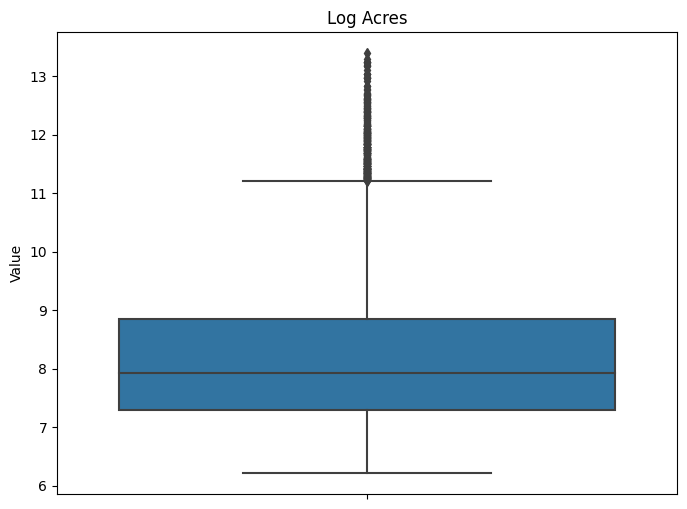

Mean: 8.197086269103227
Median: 7.920991200437808
Mode: 7.074116816197362
Range: 7.181286194452996
Variance: 1.4859547275303446
Standard Deviation: 1.218997427204153
Measure of Skewness: 1.0063583669753262


In [15]:
univariate_analysys('Log Acres', np.log(df['Acres']))

Lets also create a variable in the dataframe for the applied transformation

In [16]:
df['log_acres'] = np.log(df['Acres'])
df.head()

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/1589966964.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['log_acres'] = np.log(df['Acres'])


,Acres,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,apparent_temperature_mean,shortwave_radiation_sum,precipitation_sum,rain_sum,snowfall_sum,precipitation_hours,windspeed_10m_max,windgusts_10m_max,winddirection_10m_dominant,et0_fao_evapotranspiration,Year,Month,Distance_from_central,log_acres
0,924.0,31.8,24.3,28.0,36.3,28.2,32.5,24.88,0.8,0.8,0.0,2.0,13.6,28.1,219,5.41,2011,6,2298.376548,6.828712
1,803.0,19.3,12.1,16.0,17.3,9.6,14.4,12.90,0.0,0.0,0.0,0.0,15.2,30.2,151,2.58,2014,11,2280.436499,6.688355
2,705.0,21.6,15.1,18.7,21.1,11.5,17.0,25.75,0.0,0.0,0.0,0.0,20.6,37.1,337,5.14,1998,4,2253.240455,6.558198
3,987.0,17.4,11.1,14.2,15.2,7.3,11.4,17.76,0.0,0.0,0.0,0.0,24.1,45.4,213,2.91,1996,2,2240.070732,6.894670
4,3066.0,24.9,16.1,20.5,27.2,17.1,21.9,22.86,0.0,0.0,0.0,0.0,12.4,25.2,155,4.15,2007,3,2238.759764,8.028129


Lets analyze each of our features now

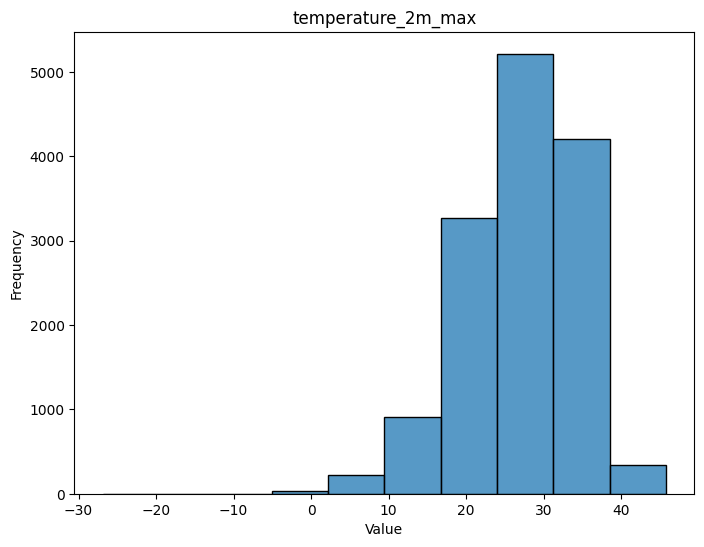

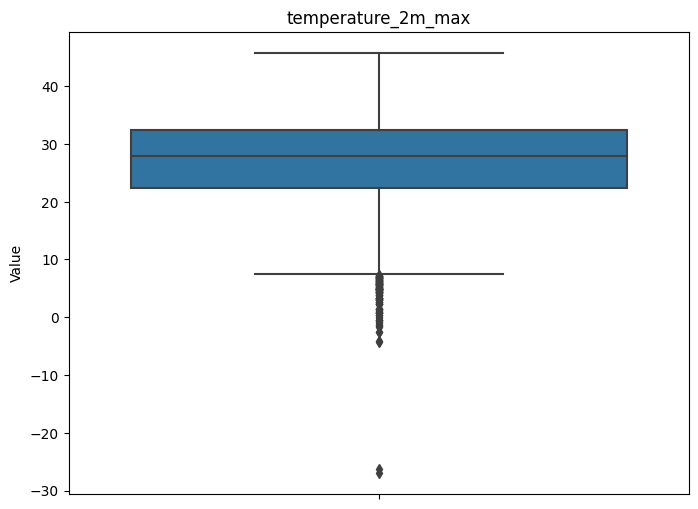

Mean: 27.06791907514451
Median: 27.9
Mode: 32.1
Range: 72.69999999999999
Variance: 51.08456749884382
Standard Deviation: 7.147346885302533
Measure of Skewness: -0.6595471250130868


In [17]:
univariate_analysys("temperature_2m_max", df['temperature_2m_max'])

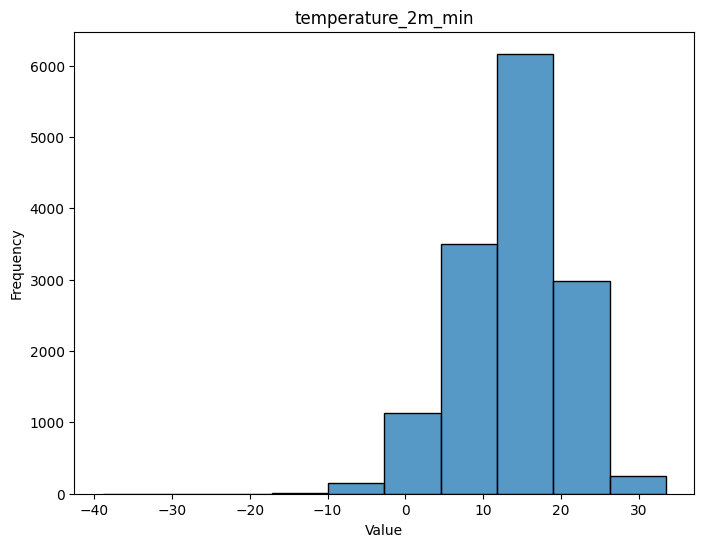

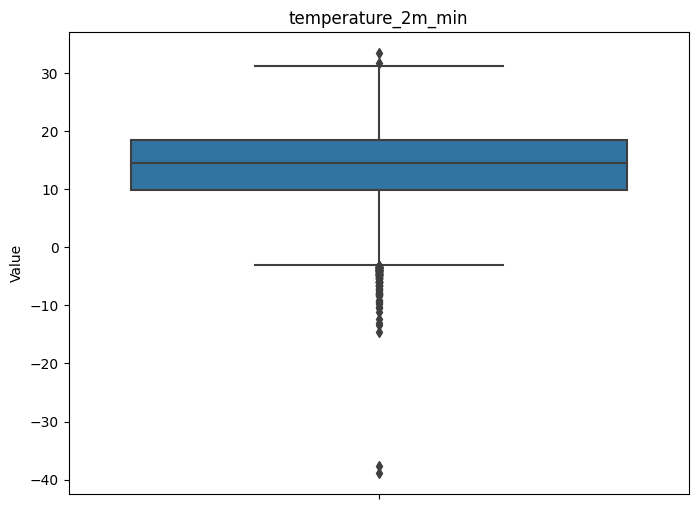

Mean: 14.026434512900043
Median: 14.6
Mode: 16.7
Range: 72.4
Variance: 44.606367786934754
Standard Deviation: 6.678799876245339
Measure of Skewness: -0.46443487604854894


In [18]:
univariate_analysys('temperature_2m_min', df['temperature_2m_min'])

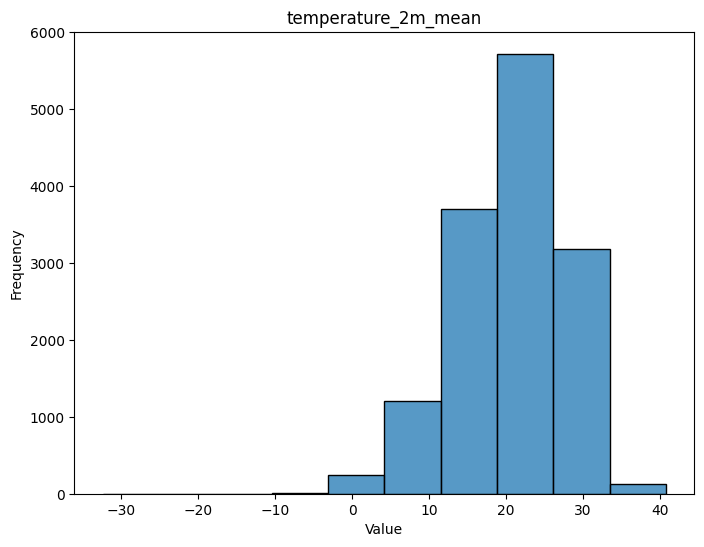

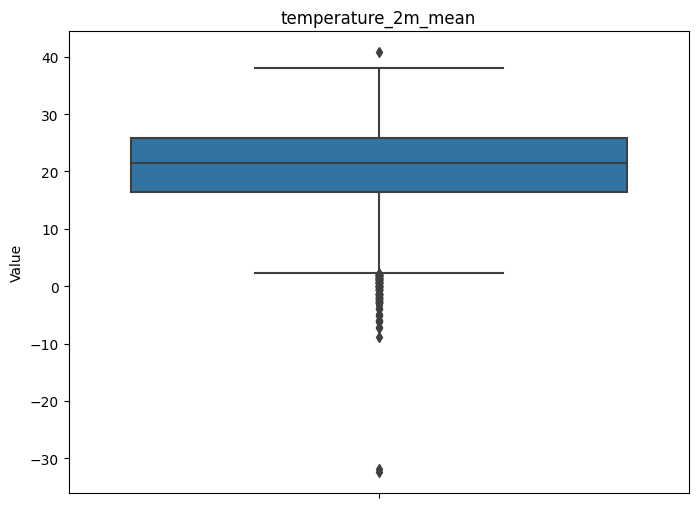

Mean: 20.660129705343298
Median: 21.4
Mode: 26.8
Range: 73.19999999999999
Variance: 47.04110464302681
Standard Deviation: 6.858651809432144
Measure of Skewness: -0.6214194300432309


In [19]:
univariate_analysys("temperature_2m_mean", df['temperature_2m_mean'])

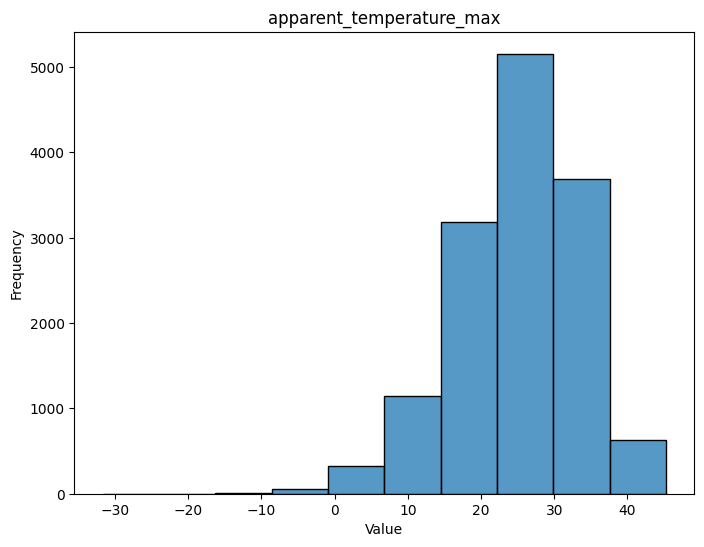

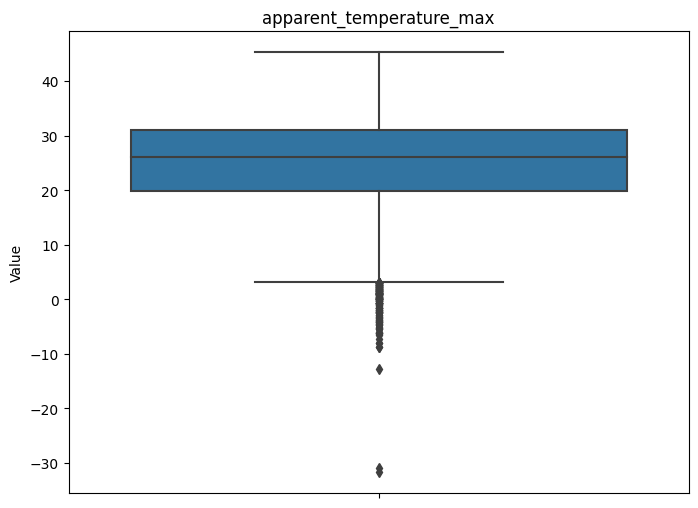

Mean: 25.087198646552938
Median: 26.0
Mode: 29.0
Range: 77.0
Variance: 69.28506981136267
Standard Deviation: 8.323765362584572
Measure of Skewness: -0.6057156163339709


In [20]:
univariate_analysys('apparent_temperature_max', df['apparent_temperature_max'])

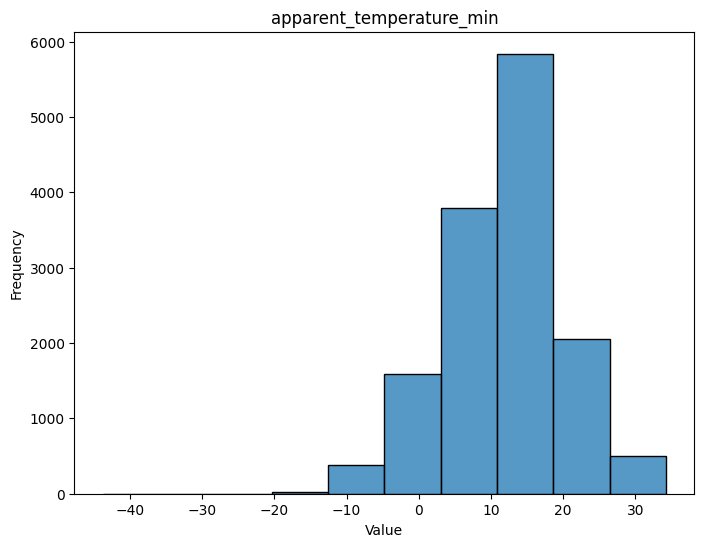

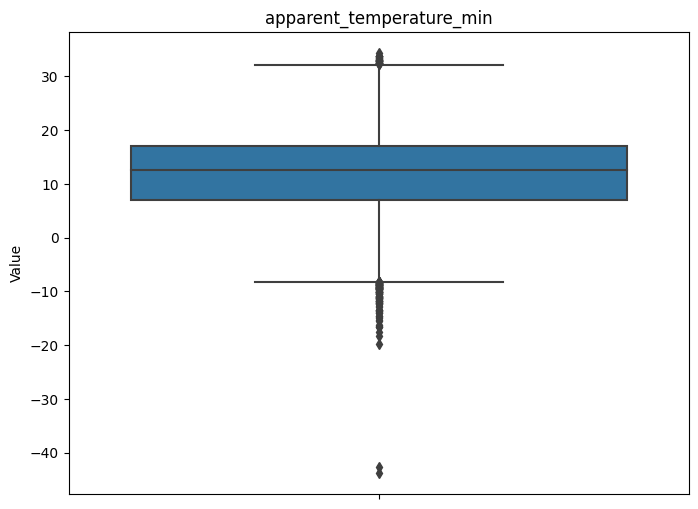

Mean: 11.89300014098407
Median: 12.6
Mode: 14.4
Range: 78.1
Variance: 64.9334208610482
Standard Deviation: 8.058127627498102
Measure of Skewness: -0.2820961914067683


In [21]:
univariate_analysys('apparent_temperature_min', df['apparent_temperature_min'])

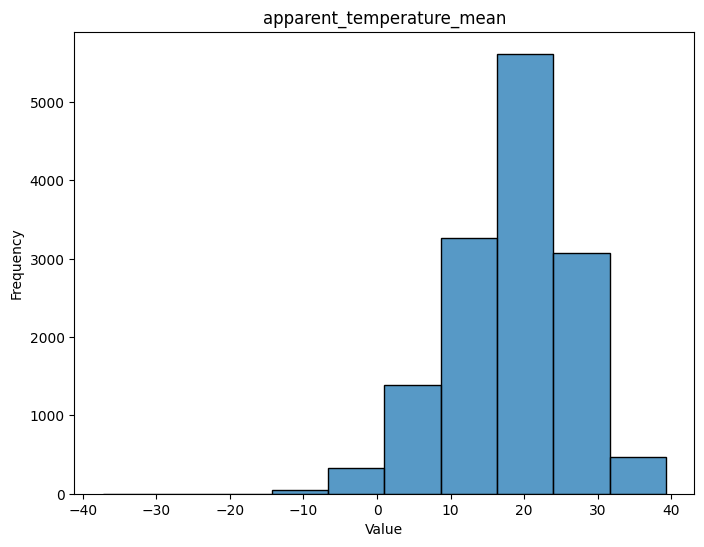

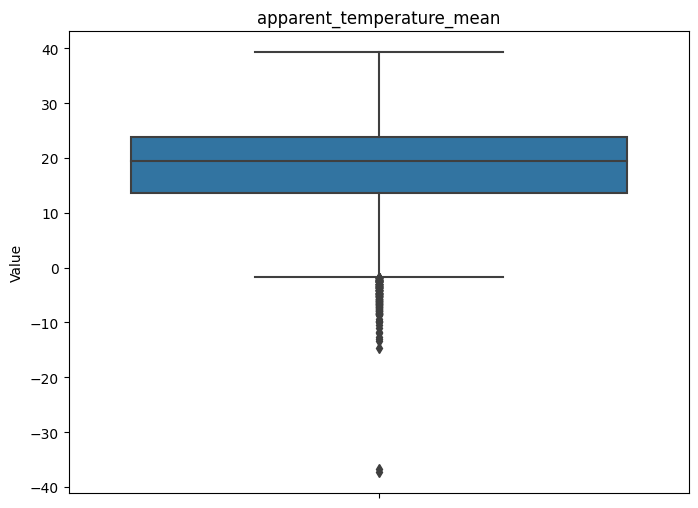

Mean: 18.424270407443956
Median: 19.4
Mode: 21.9
Range: 76.6
Variance: 63.67996148739577
Standard Deviation: 7.979972524225618
Measure of Skewness: -0.5497731214934708


In [22]:
univariate_analysys('apparent_temperature_mean', df['apparent_temperature_mean'])

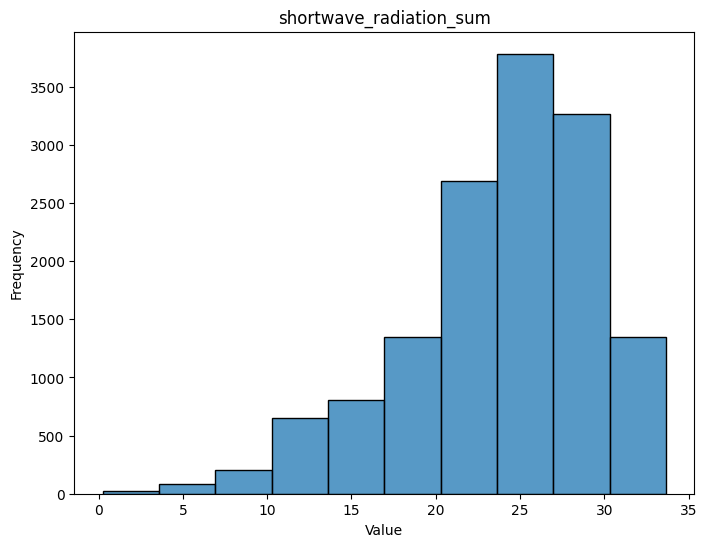

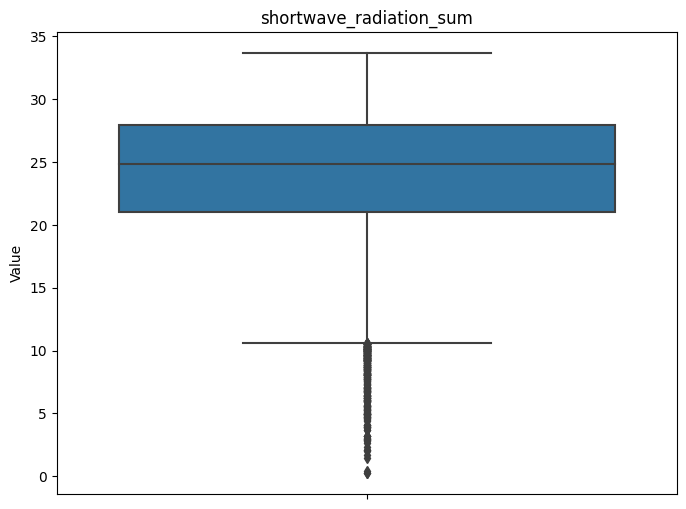

Mean: 23.86880868461864
Median: 24.83
Mode: 25.25
Range: 33.43
Variance: 31.062513913766182
Standard Deviation: 5.573375450637269
Measure of Skewness: -0.8907280403799643


In [23]:
univariate_analysys('shortwave_radiation_sum', df['shortwave_radiation_sum'])

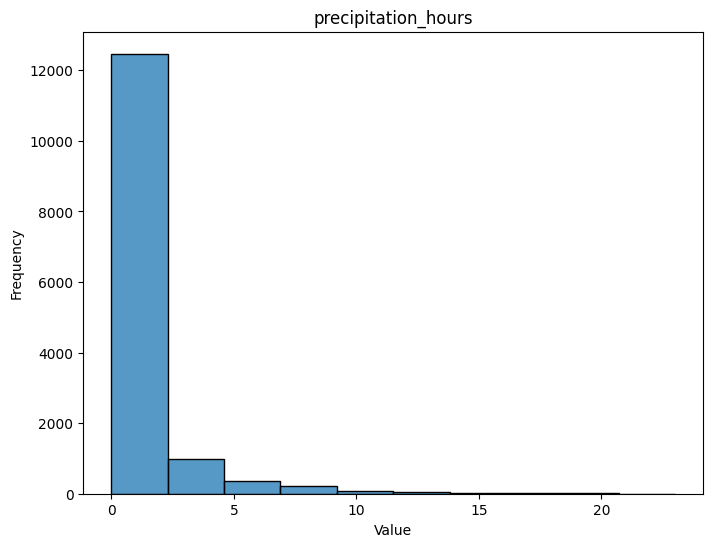

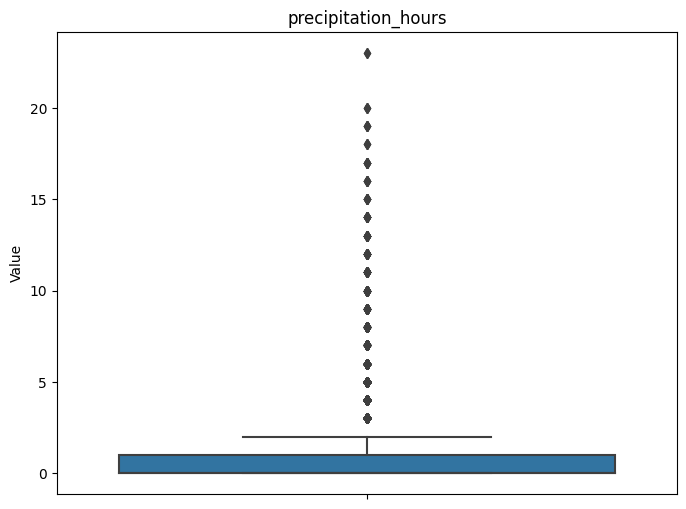

Mean: 0.8960947412942337
Median: 0.0
Mode: 0.0
Range: 23.0
Variance: 3.956351332299808
Standard Deviation: 1.989057900690628
Measure of Skewness: 3.832689722758098


In [24]:
univariate_analysys('precipitation_hours', df['precipitation_hours'])

It is right skewed.
Lets apply log transformation

In [25]:
(df['precipitation_hours'] == 0).sum()

9786

It contains 9786 values that are 0, hence log transformation cannot be applied directly.
Lets find the nearest value to 0 and lets add that alpha value to all the entries and perform log transformation

In [26]:
# Filter out zero values in the column
non_zero_values = df[df['precipitation_hours'] != 0]['precipitation_hours']

# Calculate the absolute values of the elements in the column
abs_values = np.abs(non_zero_values)

# Find the index of the minimum absolute value
min_abs_value_index = abs_values.idxmin()

# Retrieve the corresponding value in the original column
nearest_to_zero_value = df.loc[min_abs_value_index, 'precipitation_hours']

nearest_to_zero_value

1.0

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/3731605018.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['precipitation_hours_with_alpha'] = df['precipitation_hours'] + 1.0


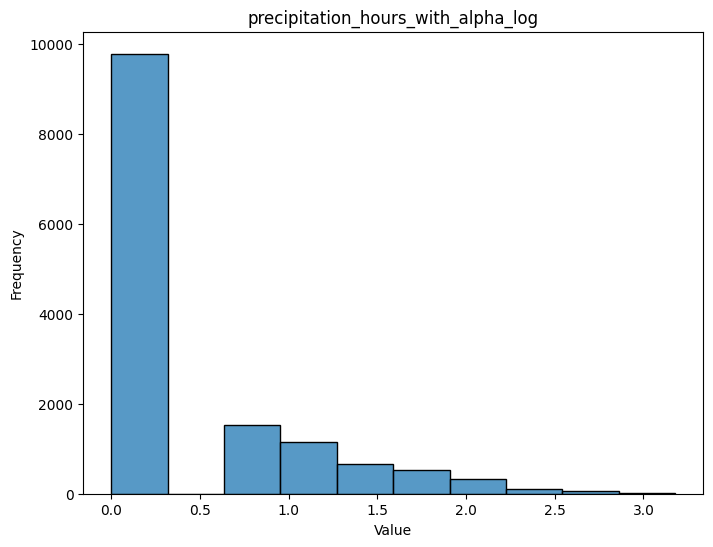

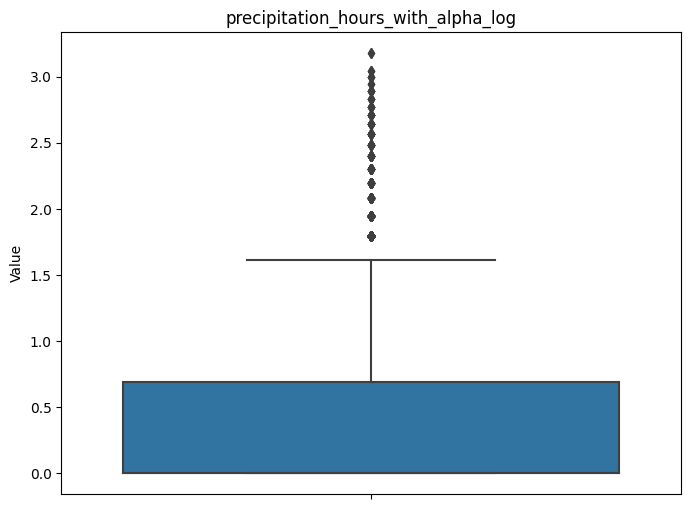

Mean: 0.37392236377199894
Median: 0.0
Mode: 0.0
Range: 3.1780538303479458
Variance: 0.3921053981038692
Standard Deviation: 0.6261831985161125
Measure of Skewness: 1.5656253216934057


In [27]:
df['precipitation_hours_with_alpha'] = df['precipitation_hours'] + 1.0
univariate_analysys('precipitation_hours_with_alpha_log', np.log(df['precipitation_hours_with_alpha']))

Lets also add this new column to the dataframe

In [28]:
df['precipitation_hours_with_alpha_log'] = np.log(df['precipitation_hours_with_alpha'])

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/1918859259.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['precipitation_hours_with_alpha_log'] = np.log(df['precipitation_hours_with_alpha'])


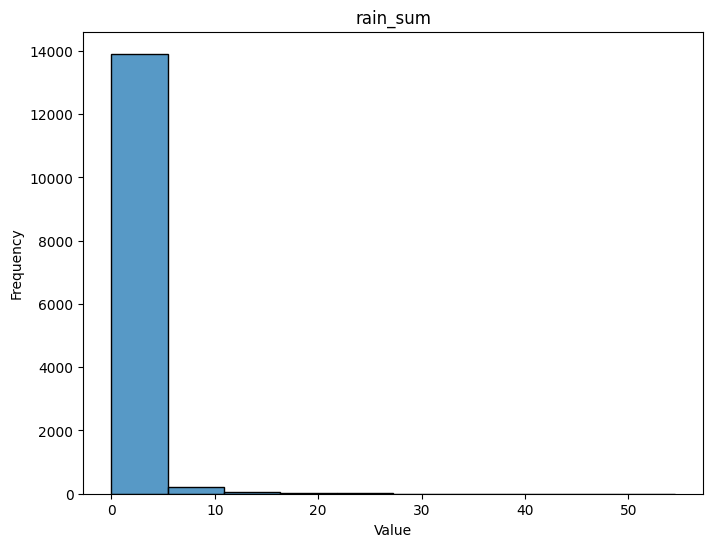

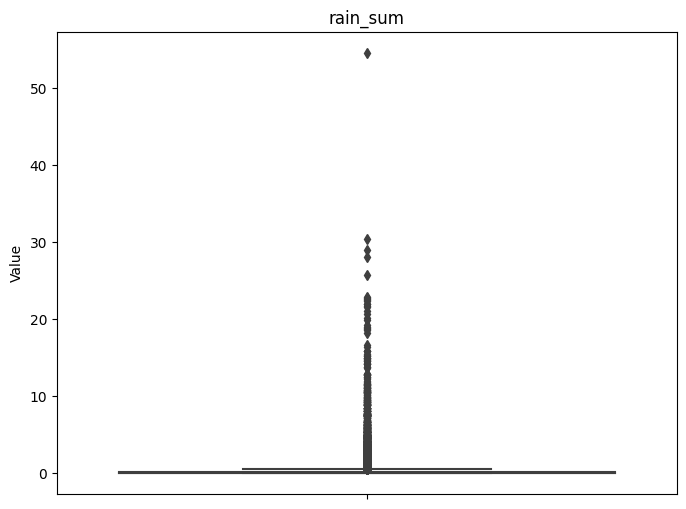

Mean: 0.5177005498378684
Median: 0.0
Mode: 0.0
Range: 54.5
Variance: 2.965289065347075
Standard Deviation: 1.722001470773784
Measure of Skewness: 8.460490810065135


In [29]:
univariate_analysys('rain_sum', df['rain_sum'])

Even this is very much skewed
Lets follow the same steps as above

In [30]:
(df['rain_sum'] == 0).sum()

9805

In [31]:
# Filter out zero values in the column
non_zero_values = df[df['rain_sum'] != 0]['rain_sum']

# Calculate the absolute values of the elements in the column
abs_values = np.abs(non_zero_values)

# Find the index of the minimum absolute value
min_abs_value_index = abs_values.idxmin()

# Retrieve the corresponding value in the original column
nearest_to_zero_value = df.loc[min_abs_value_index, 'rain_sum']

nearest_to_zero_value

0.1

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/3578982813.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['rain_sum_with_alpha'] = df['rain_sum'] + 0.1


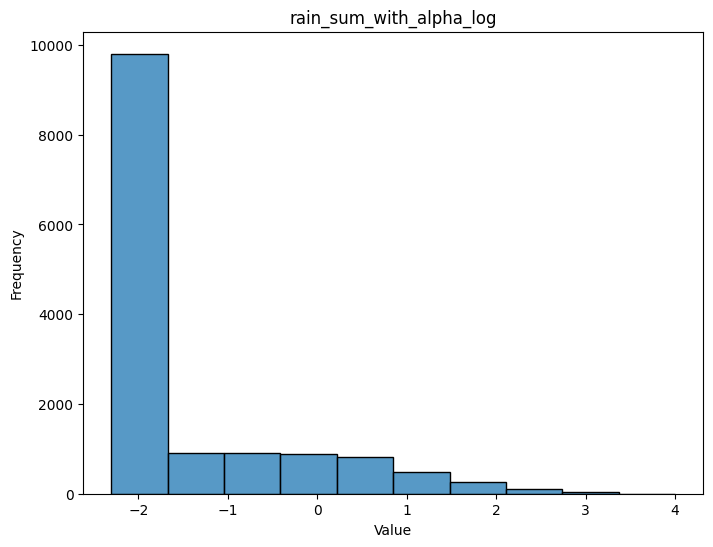

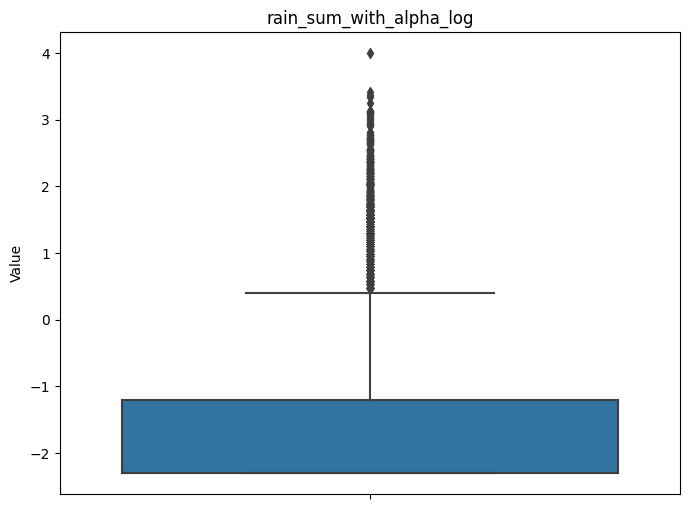

Mean: -1.6084310598085718
Median: -2.3025850929940455
Mode: -2.3025850929940455
Range: 6.302618975744904
Variance: 1.4289031471989593
Standard Deviation: 1.195367369137605
Measure of Skewness: 1.5994239587195356


In [32]:
df['rain_sum_with_alpha'] = df['rain_sum'] + 0.1
univariate_analysys('rain_sum_with_alpha_log', np.log(df['rain_sum_with_alpha']))

Lets also add this variable to our dataframe

In [33]:
df['rain_sum_with_alpha_log'] = np.log(df['rain_sum_with_alpha'])

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/1667768569.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['rain_sum_with_alpha_log'] = np.log(df['rain_sum_with_alpha'])


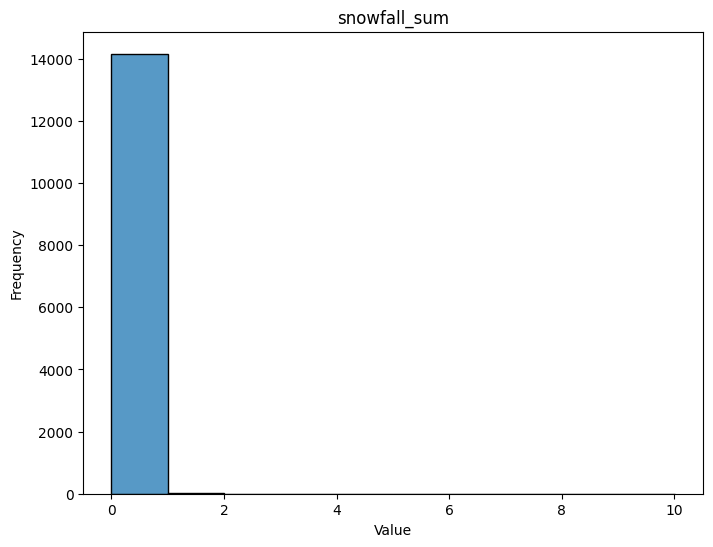

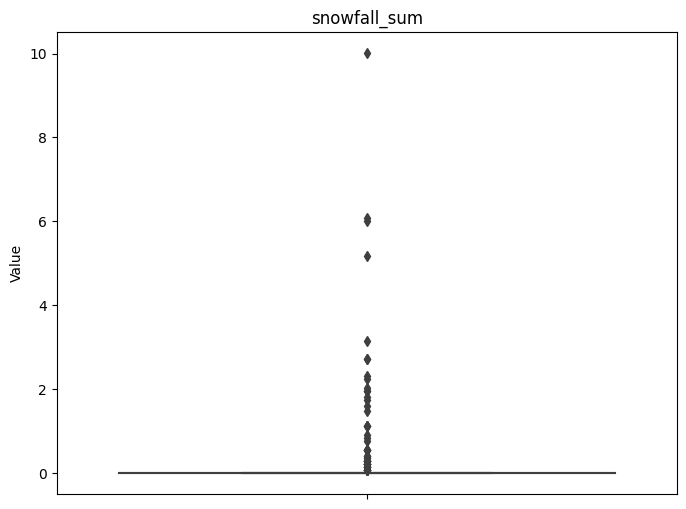

Mean: 0.004722261384463555
Median: 0.0
Mode: 0.0
Range: 10.01
Variance: 0.018819468150146453
Standard Deviation: 0.13718406667738953
Measure of Skewness: 47.17006298228038


In [34]:
univariate_analysys('snowfall_sum', df['snowfall_sum'])

Almost all values are collected towards value 0

In [35]:
(df['snowfall_sum'] == 0).sum()

14133

Here almost all values are zero. 

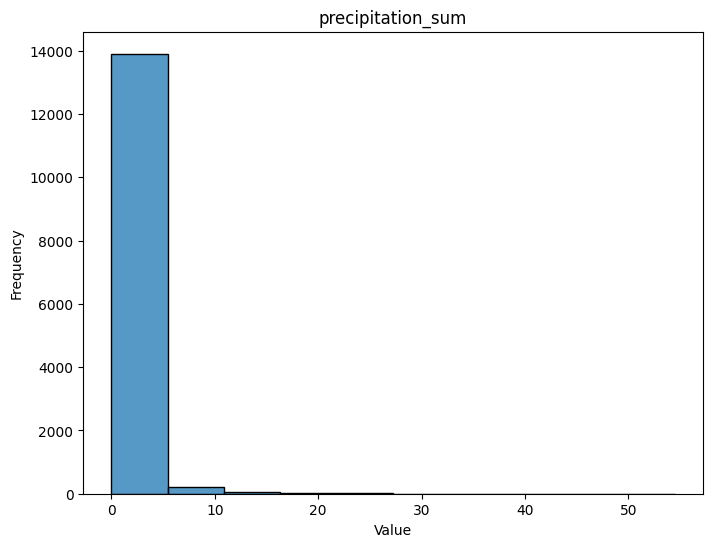

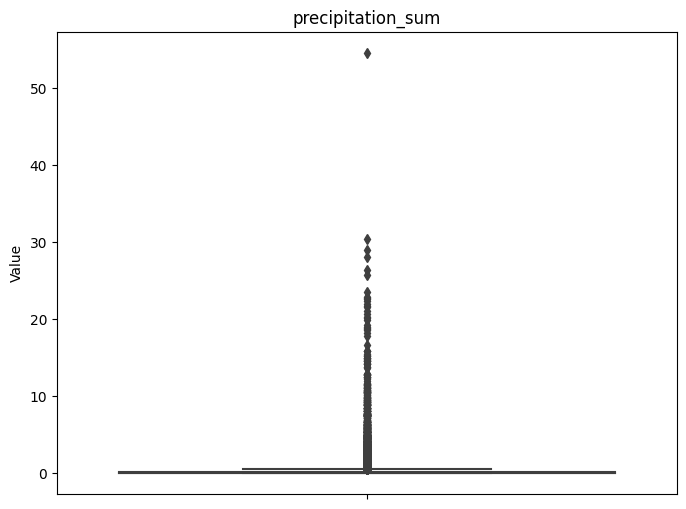

Mean: 0.5239531932891582
Median: 0.0
Mode: 0.0
Range: 54.5
Variance: 3.0464618050696095
Standard Deviation: 1.745411643443921
Measure of Skewness: 8.41211901690372


In [36]:
univariate_analysys('precipitation_sum', df['precipitation_sum'])

In [37]:
(df['precipitation_sum'] == 0).sum()

9786

In [38]:
# Filter out zero values in the column
non_zero_values = df[df['precipitation_sum'] != 0]['precipitation_sum']

# Calculate the absolute values of the elements in the column
abs_values = np.abs(non_zero_values)

# Find the index of the minimum absolute value
min_abs_value_index = abs_values.idxmin()

# Retrieve the corresponding value in the original column
nearest_to_zero_value = df.loc[min_abs_value_index, 'precipitation_sum']

nearest_to_zero_value

0.1

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/722051378.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['precipitation_sum_with_alpha'] = df['precipitation_sum'] + 0.1


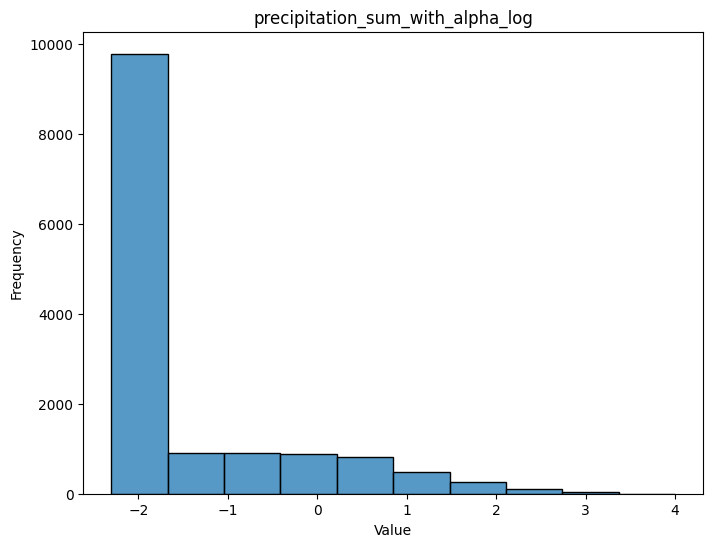

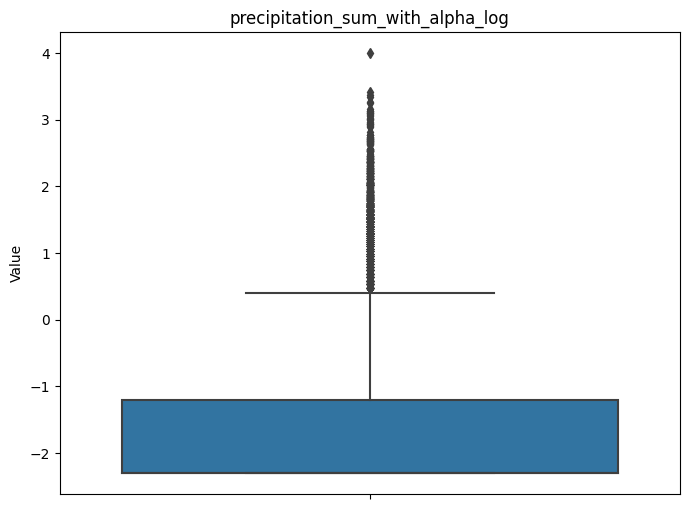

Mean: -1.6047745896457206
Median: -2.3025850929940455
Mode: -2.3025850929940455
Range: 6.302618975744904
Variance: 1.437486084261884
Standard Deviation: 1.1989520775501763
Measure of Skewness: 1.5962685654510231


In [39]:
df['precipitation_sum_with_alpha'] = df['precipitation_sum'] + 0.1
univariate_analysys('precipitation_sum_with_alpha_log', np.log(df['precipitation_sum_with_alpha']))

In [40]:
df['precipitation_sum_with_alpha_log'] = np.log(df['precipitation_sum_with_alpha'])

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/1802205858.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['precipitation_sum_with_alpha_log'] = np.log(df['precipitation_sum_with_alpha'])


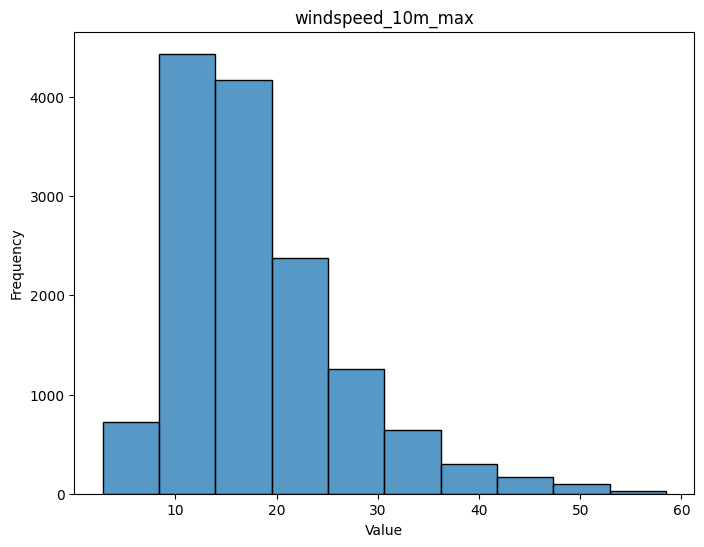

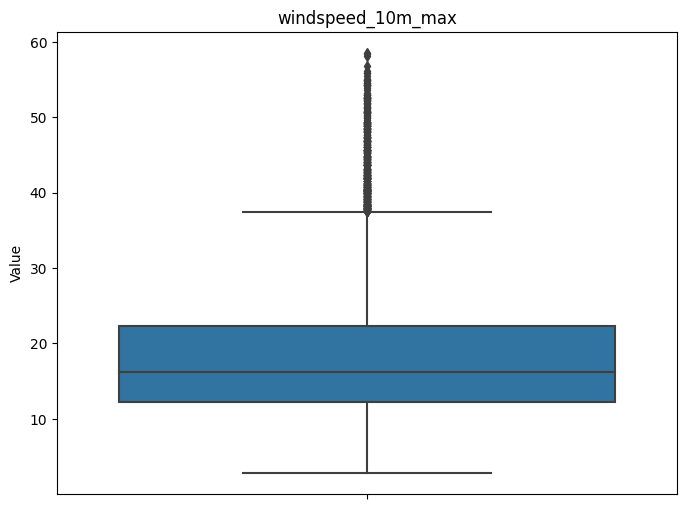

Mean: 18.179268292682924
Median: 16.2
Mode: 13.0
Range: 55.7
Variance: 70.05269741310322
Standard Deviation: 8.369748945643664
Measure of Skewness: 1.3013144454568237


In [41]:
univariate_analysys('windspeed_10m_max', df['windspeed_10m_max'])

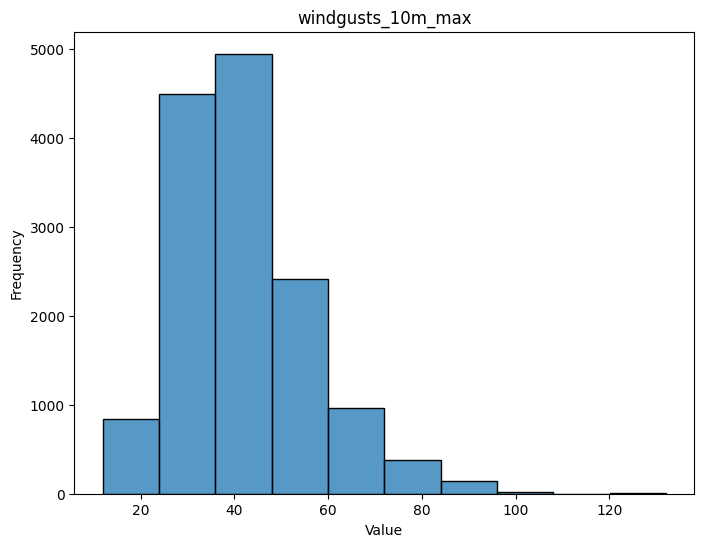

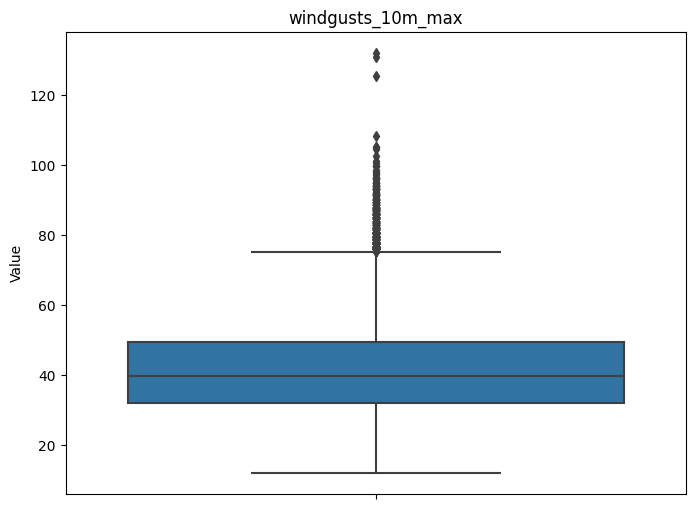

Mean: 41.94307063301847
Median: 39.6
Mode: 34.9
Range: 120.19999999999999
Variance: 195.52639434918805
Standard Deviation: 13.98307528225419
Measure of Skewness: 0.9772872677839572


In [42]:
univariate_analysys('windgusts_10m_max', df['windgusts_10m_max'])

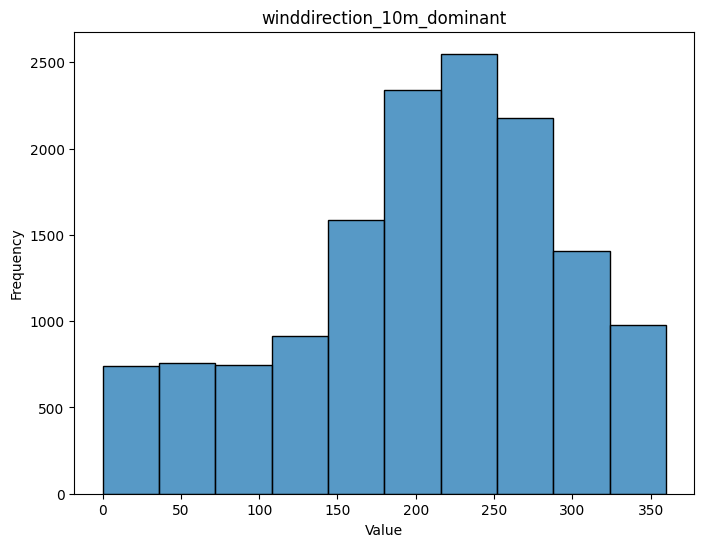

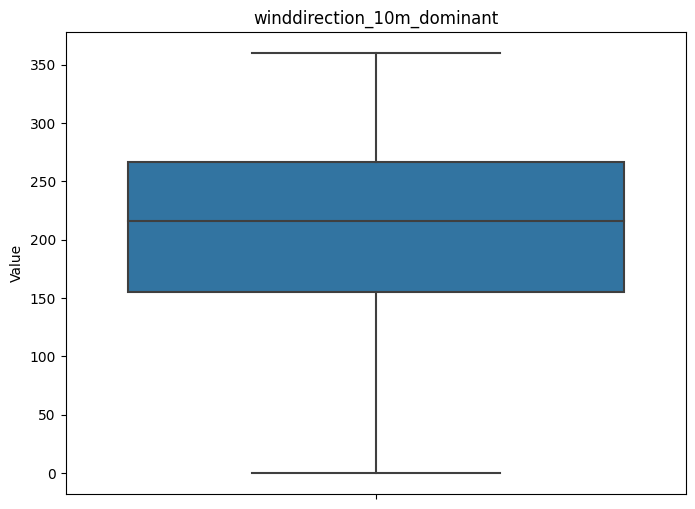

Mean: 204.22197941632595
Median: 216.0
Mode: 237
Range: 360
Variance: 7446.136199282205
Standard Deviation: 86.29099720875988
Measure of Skewness: -0.49333748776645575


In [43]:
univariate_analysys('winddirection_10m_dominant', df['winddirection_10m_dominant'])

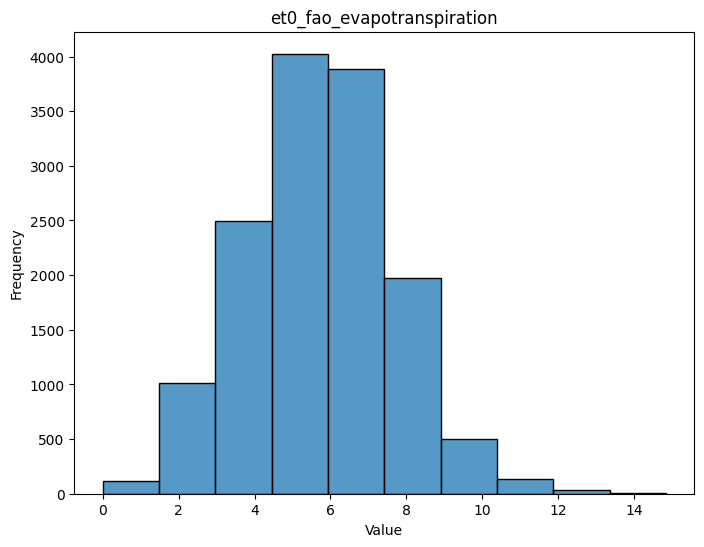

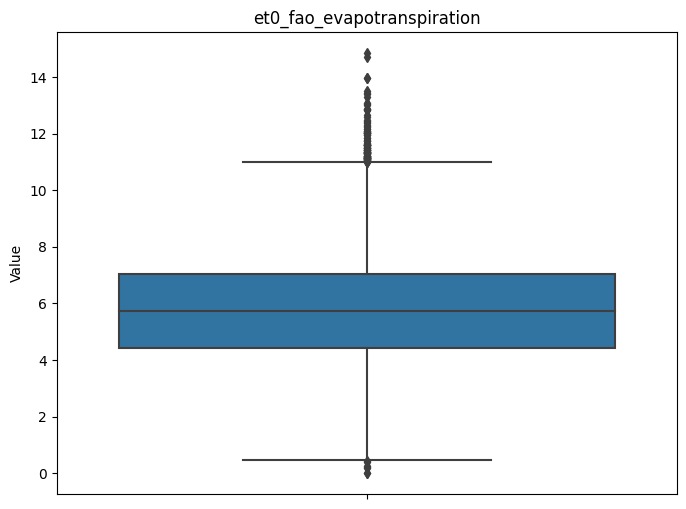

Mean: 5.73659100521641
Median: 5.735
Mode: 6.48
Range: 14.84
Variance: 3.745270380050181
Standard Deviation: 1.9352701051920844
Measure of Skewness: 0.15875565000344846


In [44]:
univariate_analysys('et0_fao_evapotranspiration', df['et0_fao_evapotranspiration'])

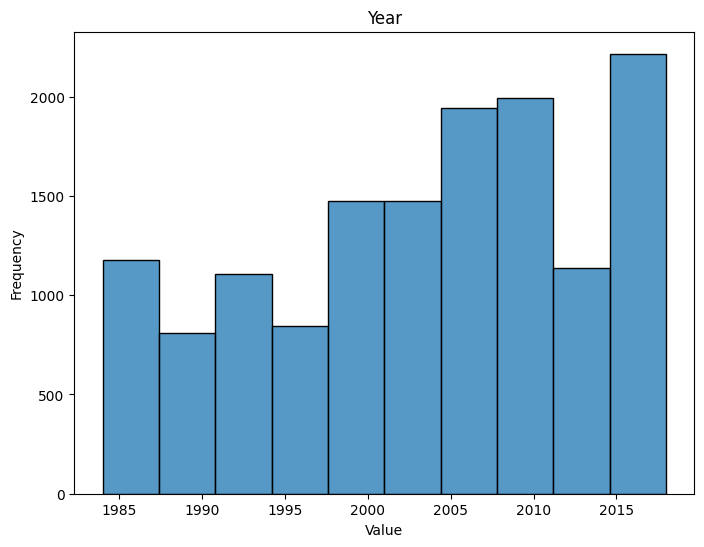

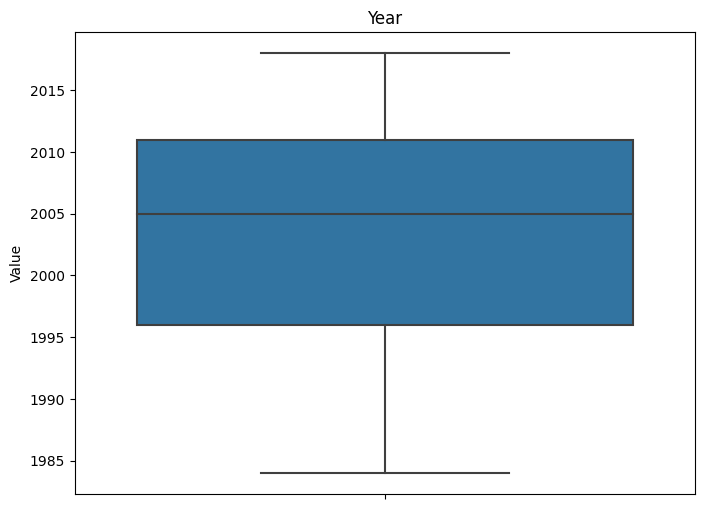

Mean: 2003.3323699421965
Median: 2005.0
Mode: 2011
Range: 34
Variance: 93.53781288138809
Standard Deviation: 9.671494862811441
Measure of Skewness: -0.3110598856803021


In [45]:
univariate_analysys('Year', df['Year'])

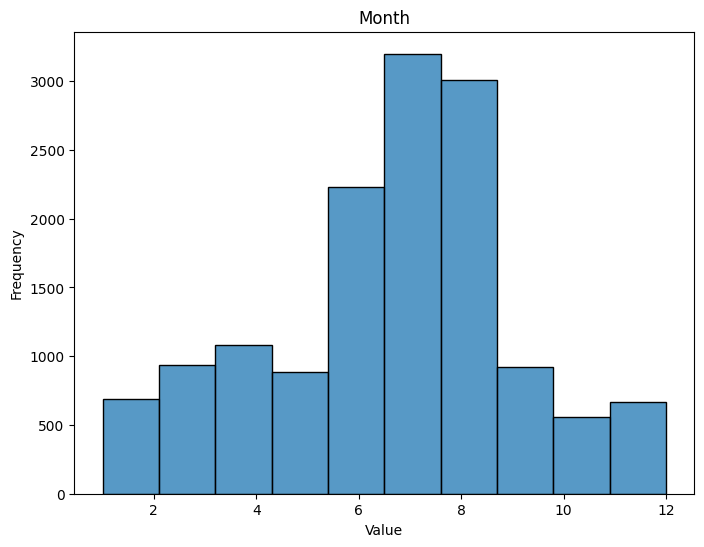

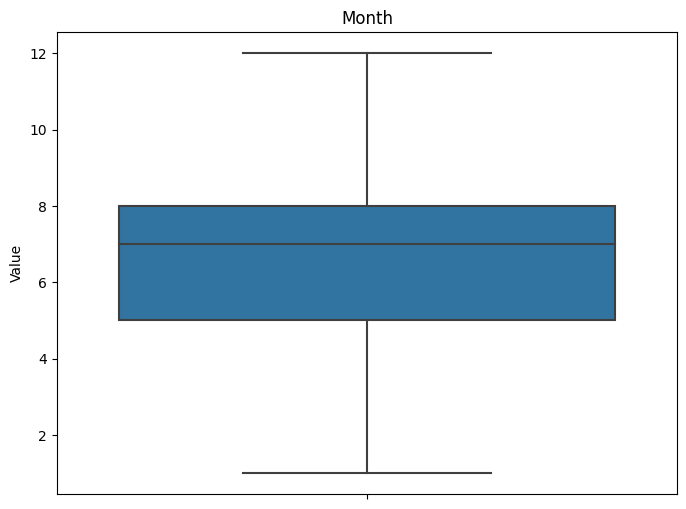

Mean: 6.6254053291978
Median: 7.0
Mode: 7
Range: 11
Variance: 5.031752126849678
Standard Deviation: 2.243156732564552
Measure of Skewness: -0.2939200652933917


In [46]:
univariate_analysys('Month', df['Month'])

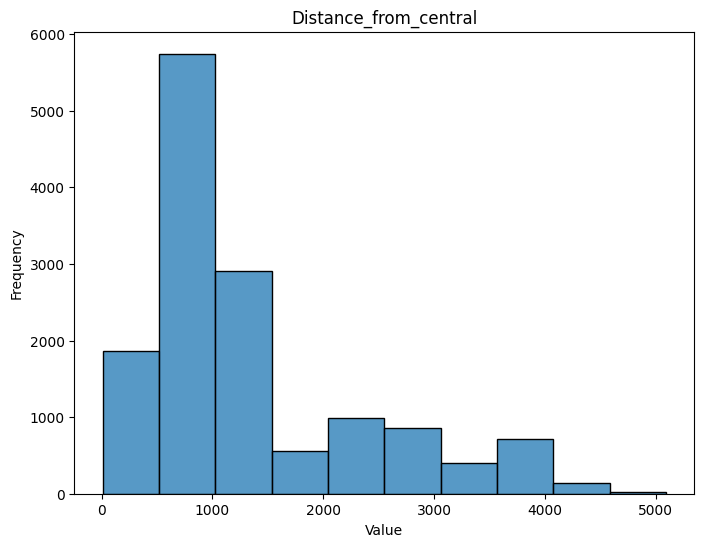

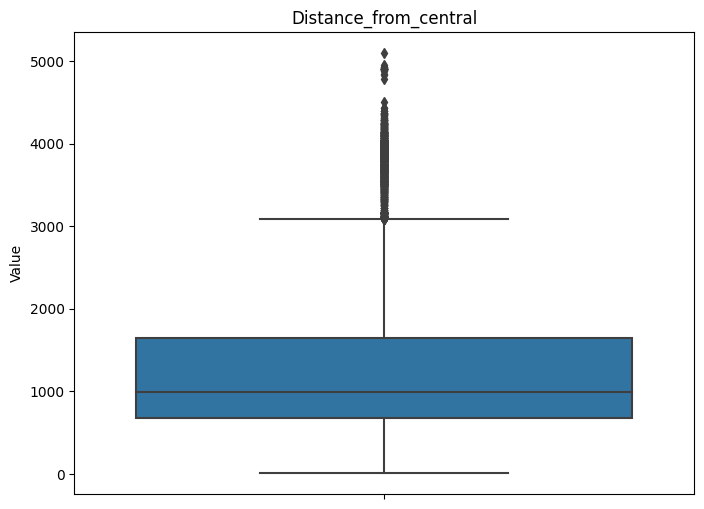

Mean: 1346.9423839835958
Median: 994.5409844541782
Mode: 849.6457019746554
Range: 5086.032203001676
Variance: 1010102.7257061533
Standard Deviation: 1005.0386687616319
Measure of Skewness: 1.329067657883262


In [47]:
univariate_analysys('Distance_from_central', df['Distance_from_central'])

In [48]:
df.columns

Index(['Acres', 'temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean',
       'shortwave_radiation_sum', 'precipitation_sum', 'rain_sum',
       'snowfall_sum', 'precipitation_hours', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central',
       'log_acres', 'precipitation_hours_with_alpha',
       'precipitation_hours_with_alpha_log', 'rain_sum_with_alpha',
       'rain_sum_with_alpha_log', 'precipitation_sum_with_alpha',
       'precipitation_sum_with_alpha_log'],
      dtype='object')

##### 4B - Bivariate Analysis

Lets setup data for bivariant analysis from previous analysis

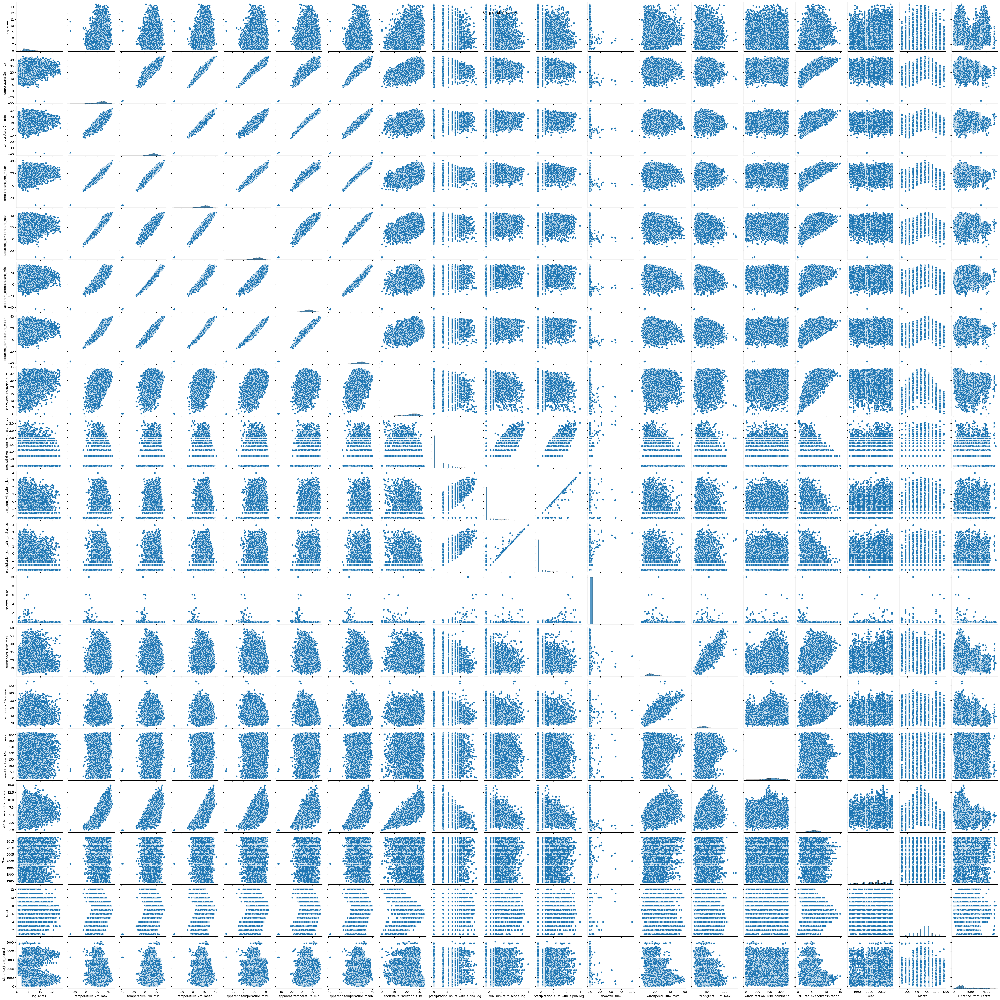

In [49]:
# Create a list of variables
variables = ['log_acres', 'temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean',
       'shortwave_radiation_sum',
       'precipitation_hours_with_alpha_log',
       'rain_sum_with_alpha_log', 'precipitation_sum_with_alpha_log', 'snowfall_sum', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central']

# Create a pairplot
sns.pairplot(df[variables])
plt.suptitle('Pairplot of Variables')
plt.show()

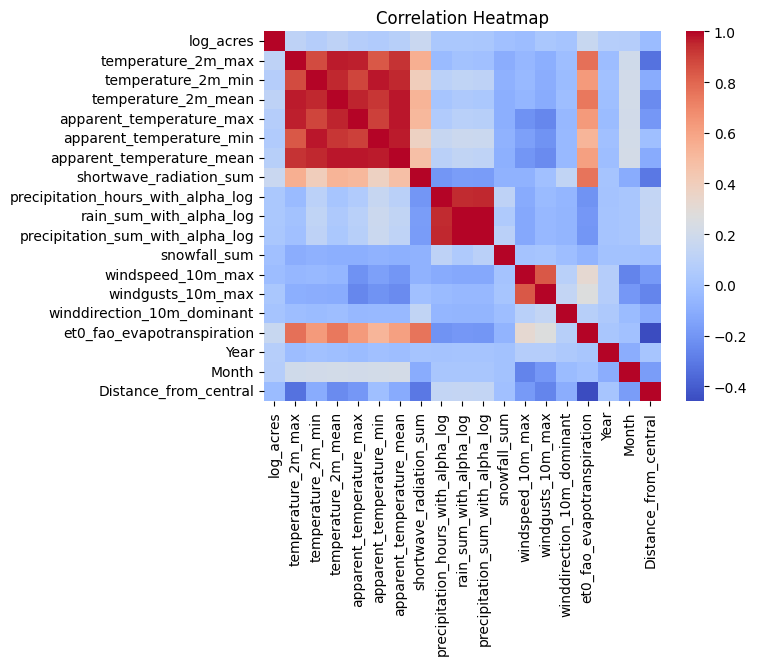

In [50]:
### Create a heatmap
variables = ['log_acres', 'temperature_2m_max', 'temperature_2m_min',
       'temperature_2m_mean', 'apparent_temperature_max',
       'apparent_temperature_min', 'apparent_temperature_mean',
       'shortwave_radiation_sum',
       'precipitation_hours_with_alpha_log',
       'rain_sum_with_alpha_log', 'precipitation_sum_with_alpha_log', 'snowfall_sum', 'windspeed_10m_max',
       'windgusts_10m_max', 'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central']
data_heat = df[variables]

sns.heatmap(data_heat.corr(), annot=False, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

### Step 5 - Documenting conclusions

From the analysis conducted: 

1. we had to transform some data to make it normal, because of the skeweness.
2. We observe no linear relation of any variable with the area and hence, it does not hold good for Linear Regression, we can verify the same.
3. We see the co-relation between the variables themselves, we can eliminate some and take only variables that matter most. 

### Step 6 - Modeling

Lets split our dataset as training and test split

In [51]:
from sklearn.model_selection import train_test_split

# Lets select only the variables that have shown some trend
X = df[['temperature_2m_mean',
       'shortwave_radiation_sum', 'precipitation_sum',
         'windspeed_10m_max',
        'winddirection_10m_dominant',
       'et0_fao_evapotranspiration', 'Distance_from_central']]  # feature columns
y = df["Acres"]  # target column

In [52]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.4, random_state = 1)

Lets confirm our intution by modelling with Linear Regression

Lets find out the best features using Stepwise Model Selection

In [54]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, explained_variance_score, mean_squared_log_error

# Initialize an empty list to store selected features
selected_features = []

# Initialize the linear regression model
model = LinearRegression()

# Step 1: Forward Selection
for feature in X_train.columns:
    # Add the feature to the selected features list
    selected_features.append(feature)
    # Fit the model with the selected features
    model.fit(X_train[selected_features], y_train)
    # Calculate the root mean squared error (RMSE) on the test set
    y_pred = model.predict(X_test[selected_features])
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print("Features: {}, RMSE: {:.4f}".format(selected_features, rmse))
    # If adding the current feature did not improve the RMSE, remove it from the selected features list
    if len(selected_features) > 1:
        if rmse > prev_rmse:
            selected_features.pop()
    prev_rmse = rmse

# Step 2: Backward Elimination
while len(selected_features) > 1:
    # Calculate the RMSE for the current set of selected features
    model.fit(X_train[selected_features], y_train)
    y_pred = model.predict(X_test[selected_features])
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    print("Features: {}, RMSE: {:.4f}".format(selected_features, rmse))
    
    # Initialize variables to keep track of the feature to remove and the improvement in RMSE
    feature_to_remove = None
    rmse_improvement = 0
    
    # Loop through the selected features to find the one that, when removed, results in the smallest RMSE improvement
    for feature in selected_features:
        temp_features = selected_features.copy()
        temp_features.remove(feature)
        model.fit(X_train[temp_features], y_train)
        y_pred = model.predict(X_test[temp_features])
        temp_rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        if rmse - temp_rmse > rmse_improvement:
            rmse_improvement = rmse - temp_rmse
            feature_to_remove = feature
    
    # Remove the feature that resulted in the smallest RMSE improvement
    try:
        selected_features.remove(feature_to_remove)
    except ValueError:
        print("Feature not found in selected_features list.")
        break

# Fit the final model with the selected features
model.fit(X_train[selected_features], y_train)

# Print the final selected features
print("Final Selected Features: ", selected_features)


Features: ['temperature_2m_mean'], RMSE: 31896.6281
Features: ['temperature_2m_mean', 'shortwave_radiation_sum'], RMSE: 31839.6578
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'precipitation_sum'], RMSE: 31839.7769
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'windspeed_10m_max'], RMSE: 31828.7871
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'windspeed_10m_max', 'winddirection_10m_dominant'], RMSE: 31827.0325
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'windspeed_10m_max', 'winddirection_10m_dominant', 'et0_fao_evapotranspiration'], RMSE: 31825.2139
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'windspeed_10m_max', 'winddirection_10m_dominant', 'et0_fao_evapotranspiration', 'Distance_from_central'], RMSE: 31704.8923
Features: ['temperature_2m_mean', 'shortwave_radiation_sum', 'windspeed_10m_max', 'winddirection_10m_dominant', 'et0_fao_evapotranspiration', 'Distance_from_central'], RMSE: 31704.8923
Features:

In [55]:
from sklearn.model_selection import train_test_split

# Lets select only the variables that have shown some trend
X = df[['temperature_2m_mean', 'shortwave_radiation_sum', 'snowfall_sum', 'et0_fao_evapotranspiration', 'Year', 'Month', 'Distance_from_central']]  # feature columns
y = df["log_acres"]  # target column

In [56]:
from sklearn.linear_model import LinearRegression
regressor = LinearRegression()
regressor.fit(X_train, y_train)

y_pred = regressor.predict(X_test)

y_true = y_test

r2 = r2_score(y_true, y_pred)
mse = mean_squared_error(y_true, y_pred)
mae = mean_absolute_error(y_true, y_pred)
rmse = np.sqrt(mean_squared_error(y_true, y_pred))
evs = explained_variance_score(y_true, y_pred)
# msle = mean_squared_log_error(y_true, y_pred)

print(f"R2 Score: {r2}")
print(f"Mean Squared Error: {mse}")
print(f"Mean Absolute Error: {mae}")
print(rmse)

R2 Score: 0.012715748654136827
Mean Squared Error: 1005261276.1875042
Mean Absolute Error: 12159.871358449449
31705.855550473705


In [57]:
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Initialize Ridge Regression model with alpha value (regularization strength)
ridge = Ridge(alpha=0.5)

# Fit the Ridge model to the training data
ridge.fit(X_train, y_train)

# Predict the target variable for the test data
y_pred = ridge.predict(X_test)

# Calculate evaluation metrics
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the evaluation metrics
print("R2 Score: ", r2)
print("Mean Squared Error: ", mse)
print("Mean Absolute Error: ", mae)

R2 Score:  0.01271596902540506
Mean Squared Error:  1005261051.8035923
Mean Absolute Error:  12159.856688912052


In [58]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

# Initialize Random Forest Regressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)

# Fit the Random Forest Regressor to the training data
rf.fit(X_train, y_train)

# Predict the target variable for the test data
y_pred = rf.predict(X_test)

# Calculate evaluation metrics
r2 = r2_score(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

# Print the evaluation metrics
print("R2 Score: ", r2)
print("Mean Squared Error: ", mse)
print("Mean Absolute Error: ", mae)

R2 Score:  -0.04130114667419038
Mean Squared Error:  1060261741.4126083
Mean Absolute Error:  13066.275265198237


As expected, our model is not capturing any relationship between the features and the target.

**Next Steps**

Our initial goal in this project was to predict the burnt area of forest fires using geographical and temporal conditions. However, after meticulous analysis and exploration of the data, we found that the features had no significant relationship with the target variable. Despite the challenges we faced, we decided to pivot the problem into a classification task with the aim of determining the severity of forest fires - whether they are severe or non-severe - based on the same set of features.

* Rationale for the Pivot:
The decision to pivot from regression to classification was based on several factors. Firstly, the lack of meaningful relationships between the features and the target variable made it challenging to accurately predict the burnt area of forest fires. We conducted rigorous data analysis and statistical tests, which confirmed this limitation. Secondly, the input from domain experts, who possess extensive knowledge and experience in the field of forest fires, was invaluable. They provided insights on the severity of fires and helped us understand that the area quantity of burnt forest is not the sole determinant of severity. Other factors, such as environmental conditions, geographical location, and temporal characteristics, also play a crucial role in determining the severity of a forest fire. Therefore, we decided to classify forest fires as severe or non-severe based on the median area quantity, as established by consensus among the domain experts.

* Benefits and Impact:
The pivot to a classification problem has several benefits and potential impacts. Firstly, it allows for a more practical and meaningful prediction of forest fire severity, which aligns with the real-world scenario faced by forest management authorities. Categorizing forest fires as severe or non-severe provides valuable information that can aid in decision-making and resource allocation for firefighting efforts. Additionally, the classification approach enables us to identify potential risk factors that contribute to severe forest fires, such as specific geographical locations, temporal patterns, or environmental conditions. This knowledge can help inform future fire prevention strategies, resource allocation, and policy-making, ultimately leading to improved forest fire management and conservation efforts.

* Conclusion:
In conclusion, the decision to pivot from regression to classification was carefully considered based on thorough data analysis, input from domain experts, and the need to provide meaningful and practical insights to the forest management authorities. The classification approach allows for a more relevant and actionable prediction of forest fire severity, which can have a significant impact on forest fire management strategies and conservation efforts. Despite the initial challenges, we remain committed to providing valuable and relevant outcomes to society, and the pivot to a classification problem is a strategic step in achieving this goal.

### Predicting Forest Fire Severity: A Classification Approach Based on Geographical and Temporal Conditions

We will continute from our previously cleaned and transformed data

In [59]:
df.describe()

,Acres,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,apparent_temperature_mean,shortwave_radiation_sum,precipitation_sum,rain_sum,...,Year,Month,Distance_from_central,log_acres,precipitation_hours_with_alpha,precipitation_hours_with_alpha_log,rain_sum_with_alpha,rain_sum_with_alpha_log,precipitation_sum_with_alpha,precipitation_sum_with_alpha_log
count,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,...,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000
mean,10426.834555,27.067919,14.026435,20.660130,25.087199,11.893000,18.424270,23.868809,0.523953,0.517701,...,2003.332370,6.625405,1346.942384,8.197086,1.896095,0.373922,0.617701,-1.608431,0.623953,-1.604775
std,30879.531354,7.147347,6.678800,6.858652,8.323765,8.058128,7.979973,5.573375,1.745412,1.722001,...,9.671495,2.243157,1005.038669,1.218997,1.989058,0.626183,1.722001,1.195367,1.745412,1.198952
min,500.000000,-26.900000,-38.900000,-32.400000,-31.700000,-43.800000,-37.300000,0.240000,0.000000,0.000000,...,1984.000000,1.000000,9.436302,6.214608,1.000000,0.000000,0.100000,-2.302585,0.100000,-2.302585
25%,1464.000000,22.400000,9.900000,16.400000,19.900000,6.900000,13.600000,21.000000,0.000000,0.000000,...,1996.000000,5.000000,681.480514,7.288928,1.000000,0.000000,0.100000,-2.302585,0.100000,-2.302585
50%,2754.500000,27.900000,14.600000,21.400000,26.000000,12.600000,19.400000,24.830000,0.000000,0.000000,...,2005.000000,7.000000,994.540984,7.920991,1.000000,0.000000,0.100000,-2.302585,0.100000,-2.302585
75%,7034.250000,32.400000,18.600000,25.800000,31.100000,17.000000,23.900000,27.940000,0.200000,0.200000,...,2011.000000,8.000000,1643.492040,8.858546,2.000000,0.693147,0.300000,-1.203973,0.300000,-1.203973
max,657299.000000,45.800000,33.500000,40.800000,45.300000,34.300000,39.300000,33.670000,54.500000,54.500000,...,2018.000000,12.000000,5095.468505,13.395894,24.000000,3.178054,54.600000,4.000034,54.600000,4.000034


In [60]:
import plotly.express as px

for column in df.columns:
    fig = px.box(df[column])
    fig.show()

#### we can keep threshold as 1000,5000 and >5000 as the different values according to the - Wildfire classification into different classes (https://www.nwcg.gov/)

In [61]:
# currently: using mean to split the points
df["spread_category"] = np.where(df["Acres"]>2754.500000, 1, 0) 

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/3237785322.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [62]:
df["spread_category"].value_counts()

spread_category
0    7093
1    7093
Name: count, dtype: int64

In [63]:
df = df[['spread_category','shortwave_radiation_sum','et0_fao_evapotranspiration','windgusts_10m_max','Distance_from_central']]

In [64]:
df.corr()

,spread_category,shortwave_radiation_sum,et0_fao_evapotranspiration,windgusts_10m_max,Distance_from_central
spread_category,1.000000,0.127206,0.127076,0.040259,-0.054048
shortwave_radiation_sum,0.127206,1.000000,0.757551,-0.013457,-0.307047
et0_fao_evapotranspiration,0.127076,0.757551,1.000000,0.269269,-0.458407
windgusts_10m_max,0.040259,-0.013457,0.269269,1.000000,-0.263009
Distance_from_central,-0.054048,-0.307047,-0.458407,-0.263009,1.000000


In [65]:
df.shape

(14186, 5)

In [66]:
df.describe()

,spread_category,shortwave_radiation_sum,et0_fao_evapotranspiration,windgusts_10m_max,Distance_from_central
count,14186.000000,14186.000000,14186.000000,14186.000000,14186.000000
mean,0.500000,23.868809,5.736591,41.943071,1346.942384
std,0.500018,5.573375,1.935270,13.983075,1005.038669
min,0.000000,0.240000,0.000000,11.900000,9.436302
25%,0.000000,21.000000,4.410000,32.000000,681.480514
50%,0.500000,24.830000,5.735000,39.600000,994.540984
75%,1.000000,27.940000,7.040000,49.300000,1643.492040
max,1.000000,33.670000,14.840000,132.100000,5095.468505


array([[<Axes: title={'center': 'spread_category'}>,
        <Axes: title={'center': 'shortwave_radiation_sum'}>],
       [<Axes: title={'center': 'et0_fao_evapotranspiration'}>,
        <Axes: title={'center': 'windgusts_10m_max'}>],
       [<Axes: title={'center': 'Distance_from_central'}>, <Axes: >]],
      dtype=object)

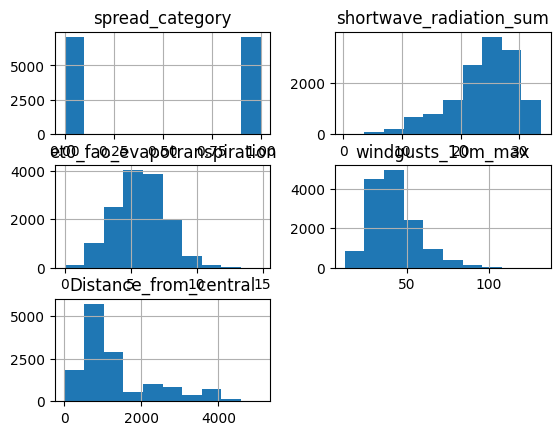

In [67]:
df.hist()

In [68]:
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import ADASYN
from imblearn.over_sampling import SMOTE

#df.drop('spread_category', axis=1, inplace=True)
X = df.drop('spread_category', axis=1)
y = df[['spread_category']]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

adasyn = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = adasyn.fit_resample(X_train, y_train)

In [69]:
y_train_resampled.value_counts()

spread_category
0                  5694
1                  5694
Name: count, dtype: int64

In [70]:
#from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, explained_variance_score, mean_squared_log_error

from sklearn.ensemble import RandomForestClassifier

rf = RandomForestClassifier(n_estimators=200, random_state=42, max_depth=15, min_samples_split=20)
rf.fit(X_train_resampled, y_train_resampled)
y_pred = rf.predict(X_test)
#mse = mean_squared_error(y_test, y_pred)

/var/folders/bg/srxz40bj7md1r8ryyh39_vnr0000gn/T/ipykernel_44928/591430596.py:6: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



In [71]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.67      0.51      0.58      1399
           1       0.61      0.75      0.68      1439

    accuracy                           0.64      2838
   macro avg       0.64      0.63      0.63      2838
weighted avg       0.64      0.64      0.63      2838



In [72]:
rf.score(X_train, y_train)

0.7810186817060275

In [73]:
rf.score(X_test, y_test)

0.6356589147286822

In [74]:
# Checking in xgboost model
import xgboost as xgb
from sklearn.metrics import accuracy_score

In [75]:
params = {
    'objective': 'binary:logistic',   # classification objective function
    'max_depth': 23,                   # maximum tree depth
    'learning_rate': 0.01,             # learning rate
    'n_estimators': 150               # number of trees to build
}

# Train the XGBoost classifier on the training data
clf = xgb.XGBClassifier(**params)
clf.fit(X_train, y_train)

# Make predictions on the testing data
y_pred = clf.predict(X_test)

# Calculate accuracy of the predictions
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy: %.2f%%' % (accuracy * 100.0))

Accuracy: 60.11%


In [76]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.60      0.55      0.58      1399
           1       0.60      0.65      0.62      1439

    accuracy                           0.60      2838
   macro avg       0.60      0.60      0.60      2838
weighted avg       0.60      0.60      0.60      2838

